<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Notebook-to-run-Walk-Forward-Optimization-with-'memory'-starting-at-different-years" data-toc-modified-id="Notebook-to-run-Walk-Forward-Optimization-with-'memory'-starting-at-different-years-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Notebook to run Walk Forward Optimization with 'memory' starting at different years</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Imports" data-toc-modified-id="Imports-1.0.1"><span class="toc-item-num">1.0.1&nbsp;&nbsp;</span>Imports</a></span></li></ul></li><li><span><a href="#Load-data" data-toc-modified-id="Load-data-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Load data</a></span></li></ul></li><li><span><a href="#Visualization" data-toc-modified-id="Visualization-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Visualization</a></span><ul class="toc-item"><li><span><a href="#Parameters" data-toc-modified-id="Parameters-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Parameters</a></span></li><li><span><a href="#Cummulative-returns-&amp;-Metrics" data-toc-modified-id="Cummulative-returns-&amp;-Metrics-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Cummulative returns &amp; Metrics</a></span><ul class="toc-item"><li><span><a href="#Dynamic-plot" data-toc-modified-id="Dynamic-plot-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Dynamic plot</a></span></li></ul></li><li><span><a href="#Metrics" data-toc-modified-id="Metrics-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Metrics</a></span></li></ul></li><li><span><a href="#Conclusion" data-toc-modified-id="Conclusion-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Conclusion</a></span></li></ul></div>

# Notebook to run Walk Forward Optimization with 'memory' starting at different years

### Imports

In [1]:
# Settings for notebook visualization
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
%matplotlib inline
from IPython.core.display import HTML
HTML("""<style>.output_png img {display: block;margin-left: auto;margin-right: auto;text-align: center;vertical-align: middle;} </style>""")

In [2]:
# Necessary imports
import os
import numpy as np
import pandas as pd
import matplotlib as plt
from ipywidgets import widgets
from tqdm.auto import tqdm, trange
import plotly.express as px
print("Libraries imported correctly")

Libraries imported correctly


In [3]:
os.chdir("/Users/Sergio/Documents/Master_QF/Thesis/Code/Algorithmic Strategies")
%run Functions.ipynb

## Load data

In [4]:
import pickle
with open('data/sell_in_may/results_sell_in_may_short.pickle', 'rb') as file:
    results_short = pickle.load(file)

with open('data/sell_in_may/results_sell_in_may_long.pickle', 'rb') as file:
    results_long = pickle.load(file)

results_short.keys()
results_short[list(results_short.keys())[0]].keys()

dict_keys(['shortlist_mem0_IS3', 'shortlist_mem0_IS5', 'shortlist_mem0_IS10', 'shortlist_mem2_IS3', 'shortlist_mem2_IS5', 'shortlist_mem2_IS10', 'shortlist_mem4_IS3', 'shortlist_mem4_IS5', 'shortlist_mem4_IS10'])

dict_keys(['df', 'indiv_ir_list', 'market_ir_list', 'robust_ir_list', 'weights_list', 'cummulated_weights_list', 'params_combinations', 'metrics'])

In [5]:
all_names_long = list(results_long.keys())
all_dfs_long = deeper_get(results_long, ['df'])
all_indiv_ir_list_long = deeper_get(results_long, ['indiv_ir_list'])
all_market_ir_list_long = deeper_get(results_long, ['market_ir_list'])
all_robust_ir_list_long = deeper_get(results_long, ['robust_ir_list'])
all_weights_list_long = deeper_get(results_long, ['weights_list'])
all_cummulated_weights_list_long = deeper_get(results_long, ['cummulated_weights_list'])
all_params_combinations_long = deeper_get(results_long, ['params_combinations'])
all_metrics_long = deeper_get(results_long, ['metrics'])
print(f'Number of days: {len(all_dfs_long[0])}')

all_names_short = list(results_short.keys())
all_dfs_short = deeper_get(results_short, ['df'])
all_indiv_ir_list_short = deeper_get(results_short, ['indiv_ir_list'])
all_market_ir_list_short = deeper_get(results_short, ['market_ir_list'])
all_robust_ir_list_short = deeper_get(results_short, ['robust_ir_list'])
all_weights_list_short = deeper_get(results_short, ['weights_list'])
all_cummulated_weights_list_short = deeper_get(results_short, ['cummulated_weights_list'])
all_params_combinations_short = deeper_get(results_short, ['params_combinations'])
all_metrics_short = deeper_get(results_short, ['metrics'])

Number of days: 9075


# Visualization

## Parameters

In [6]:
params = pd.DataFrame()
for p, name in zip(all_params_combinations_short, all_names_short):
    p = p.set_index(p.index.astype(str) + f'_{name}')
    params = pd.concat([params, p])
for p, name in zip(all_params_combinations_long, all_names_long):
    p = p.set_index(p.index.astype(str) + f'_{name}')
    params = pd.concat([params, p])

params = params.drop_duplicates().sort_index()
params.head()
params.tail()

,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sell_duration_longlist_mem0_IS10,1,2,2,2,2,2,4,3,4,4,4,4,4,3,3,3,1,3,4,3,3,9,9,9,9,10,10,10,10,10,10,10,10,9,1,5
sell_duration_longlist_mem0_IS3,8,1,6,5,5,3,3,4,5,1,10,2,2,1,2,3,6,9,9,8,9,3,8,1,9,10,10,8,8,8,3,4,8,2,10,1
sell_duration_longlist_mem0_IS5,8,7,3,3,3,4,4,4,3,3,6,1,1,1,2,2,2,3,9,9,9,9,9,3,10,10,10,9,9,4,6,5,2,2,2,2
sell_duration_longlist_mem2_IS10,1,1,2,2,2,2,2,2,4,4,4,4,4,4,3,3,2,3,3,3,3,3,9,9,9,9,10,10,10,10,10,10,10,10,10,5
sell_duration_longlist_mem2_IS3,8,3,3,2,5,3,4,4,3,5,2,5,3,1,2,2,3,9,9,9,9,9,9,3,10,10,10,10,10,5,8,5,2,2,6,2


,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sell_month_shortlist_mem2_IS3,1,5,5,9,7,9,8,8,8,6,9,2,2,3,7,7,7,7,5,5,6,6,6,1,2,10,9,10,8,5,4,5,12,8,12,12
sell_month_shortlist_mem2_IS5,12,1,5,9,9,9,8,8,8,8,8,8,9,3,3,7,7,7,7,7,4,4,4,6,6,6,9,9,9,9,5,5,5,5,12,12
sell_month_shortlist_mem4_IS10,9,2,1,9,9,9,9,9,9,8,8,8,8,8,8,8,8,8,7,7,7,7,7,6,6,6,6,6,6,6,5,5,5,5,8,5
sell_month_shortlist_mem4_IS3,1,5,5,9,9,9,8,8,8,8,8,9,9,2,2,7,7,7,7,5,5,6,6,6,6,10,10,10,9,8,8,5,5,8,12,12
sell_month_shortlist_mem4_IS5,12,1,5,5,9,9,9,8,8,8,8,8,8,8,8,8,7,7,7,7,7,7,4,6,6,6,10,10,9,9,9,5,5,5,5,8


By checking the histogram of chosen parameters using a long list of parameters (allowing sell_duration to be up to 12 months), we can see how we don´t achieve the goal of the strategy, which is to avoid the worse months. Instead, strategy chooses very often to be long only during months with the best performance.  
An option to avoid this, is to shortened the sell_duration parameters, to allow up to 6 months only. Making the strategy to be long most of the time, and trying to avoid the worst months only.

,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sell_duration_longlist_mem0_IS10,1,2,2,2,2,2,4,3,4,4,4,4,4,3,3,3,1,3,4,3,3,9,9,9,9,10,10,10,10,10,10,10,10,9,1,5
sell_duration_longlist_mem0_IS3,8,1,6,5,5,3,3,4,5,1,10,2,2,1,2,3,6,9,9,8,9,3,8,1,9,10,10,8,8,8,3,4,8,2,10,1
sell_duration_longlist_mem0_IS5,8,7,3,3,3,4,4,4,3,3,6,1,1,1,2,2,2,3,9,9,9,9,9,3,10,10,10,9,9,4,6,5,2,2,2,2
sell_duration_longlist_mem2_IS10,1,1,2,2,2,2,2,2,4,4,4,4,4,4,3,3,2,3,3,3,3,3,9,9,9,9,10,10,10,10,10,10,10,10,10,5
sell_duration_longlist_mem2_IS3,8,3,3,2,5,3,4,4,3,5,2,5,3,1,2,2,3,9,9,9,9,9,9,3,10,10,10,10,10,5,8,5,2,2,6,2
sell_duration_longlist_mem2_IS5,8,7,7,2,3,3,4,4,4,4,3,4,1,1,1,2,2,3,9,9,9,9,9,9,6,10,9,9,10,10,9,5,5,5,2,2
sell_duration_longlist_mem4_IS10,1,1,2,2,2,2,2,2,2,4,4,4,4,4,4,3,3,2,3,3,3,3,3,9,9,9,9,10,10,10,10,10,10,10,10,9
sell_duration_longlist_mem4_IS3,8,3,3,2,3,3,4,4,4,4,3,2,1,2,2,2,2,3,9,9,9,9,9,9,10,10,9,10,10,10,9,5,5,2,2,2
sell_duration_longlist_mem4_IS5,8,7,7,3,2,3,3,4,4,4,4,4,3,2,2,1,2,3,9,9,9,9,9,9,9,10,9,9,10,10,10,9,9,5,2,2


<AxesSubplot:title={'center':'Frequency of each sell_duration possibility'}, ylabel='Frequency'>

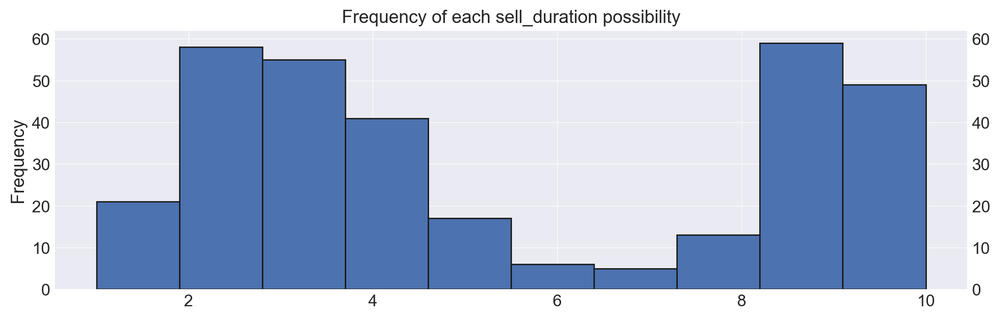

In [7]:
params[params.index.str.contains('sell_duration_longlist')]
params[params.index.str.contains('sell_duration_longlist')].stack().plot(kind='hist', title='Frequency of each sell_duration possibility')

In [8]:
params.loc[['sell_month_shortlist_mem0_IS10', 'sell_duration_shortlist_mem0_IS10'], :]

,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sell_month_shortlist_mem0_IS10,9,1,1,9,9,9,7,9,8,8,8,8,8,8,8,7,8,7,6,7,7,7,7,6,5,1,1,6,1,5,5,5,8,8,5,5
sell_duration_shortlist_mem0_IS10,2,2,2,2,2,2,4,3,4,4,4,4,4,3,3,3,1,3,4,3,3,3,3,4,5,2,2,4,1,6,2,5,6,6,2,5


,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sell_duration_shortlist_mem0_IS10,2,2,2,2,2,2,4,3,4,4,4,4,4,3,3,3,1,3,4,3,3,3,3,4,5,2,2,4,1,6,2,5,6,6,2,5
sell_duration_shortlist_mem0_IS3,6,3,4,6,6,3,3,4,5,3,6,2,2,1,2,3,5,5,5,6,4,3,6,1,6,6,6,2,6,5,3,4,2,2,6,1
sell_duration_shortlist_mem0_IS5,4,3,3,3,3,4,4,4,3,3,6,1,2,1,2,2,2,3,6,6,6,6,6,3,6,5,6,6,6,4,6,5,2,2,2,2
sell_duration_shortlist_mem2_IS10,2,1,2,2,2,2,2,2,4,4,4,4,4,4,3,3,2,3,3,3,3,3,3,4,4,5,5,5,4,5,6,6,6,6,6,5
sell_duration_shortlist_mem2_IS3,6,3,3,3,6,3,4,4,3,6,1,5,3,1,2,2,3,3,5,5,4,4,4,3,6,5,6,5,6,5,6,5,2,2,2,2
sell_duration_shortlist_mem2_IS5,4,6,3,2,3,3,4,4,4,4,3,4,1,1,1,2,2,3,3,3,6,6,6,4,6,6,6,6,6,6,6,5,5,5,2,2
sell_duration_shortlist_mem4_IS10,2,1,2,2,2,2,2,2,2,4,4,4,4,4,4,3,3,2,3,3,3,3,3,4,4,5,5,5,5,5,6,6,6,6,6,5
sell_duration_shortlist_mem4_IS3,6,3,3,2,3,3,4,4,4,4,3,1,1,2,2,2,2,3,3,5,5,4,4,4,4,6,6,5,6,6,6,5,5,2,2,2
sell_duration_shortlist_mem4_IS5,4,6,3,3,2,3,3,4,4,4,4,4,3,2,2,1,2,3,3,3,3,3,6,4,4,4,6,5,6,6,6,6,6,5,5,2


<AxesSubplot:ylabel='Frequency'>

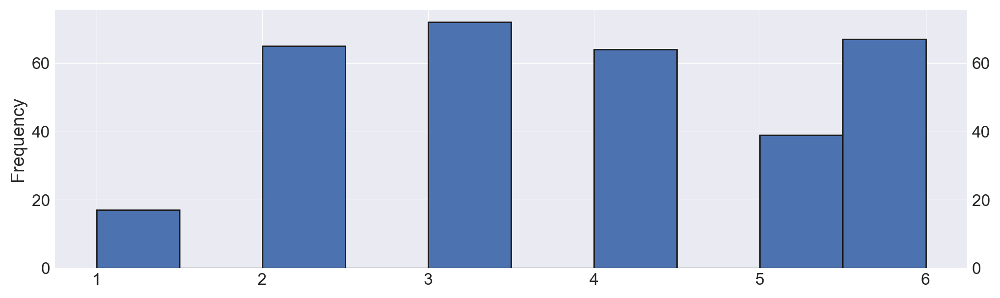

In [9]:
params[params.index.str.contains('sell_duration_shortlist')]
params[params.index.str.contains('sell_duration_shortlist')].stack().plot(kind='hist')

## Cummulative returns & Metrics

longlist_mem0_IS3: 	AbsRet: 779.0 	IR: 0.39
longlist_mem0_IS5: 	AbsRet: 741.0 	IR: 0.37
longlist_mem0_IS10: 	AbsRet: 698.0 	IR: 0.39
longlist_mem2_IS3: 	AbsRet: 658.0 	IR: 0.36
longlist_mem2_IS5: 	AbsRet: 341.0 	IR: 0.23
longlist_mem2_IS10: 	AbsRet: 618.0 	IR: 0.37
longlist_mem4_IS3: 	AbsRet: 608.0 	IR: 0.35
longlist_mem4_IS5: 	AbsRet: 474.0 	IR: 0.31
longlist_mem4_IS10: 	AbsRet: 526.0 	IR: 0.33


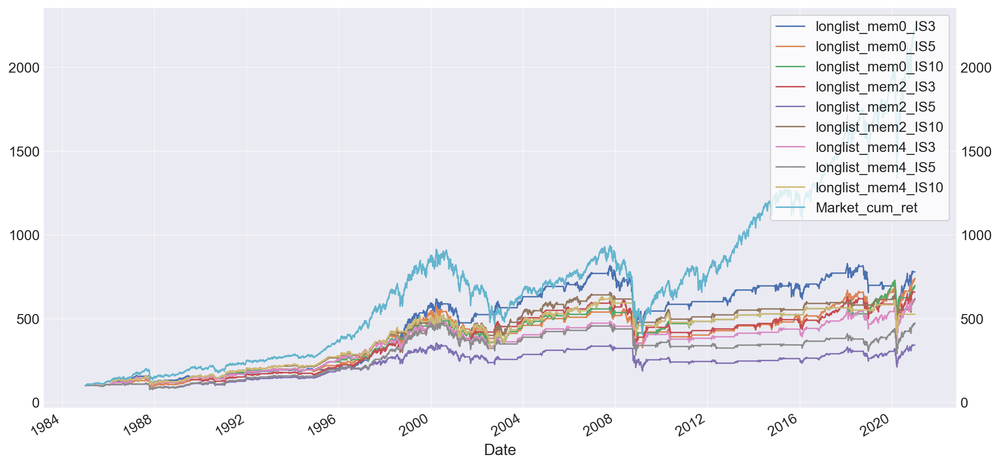

In [10]:
for df, m, strat_name in zip(all_dfs_long, all_metrics_long, all_names_long):
    absret = df['Strat_cum_ret'].iloc[-1].round(0)
    ir = m['IR'].iloc[0].round(2)
    print(f'{strat_name}: \tAbsRet: {absret} \tIR: {ir}')
    _ = df['Strat_cum_ret'].plot(label=strat_name, legend=True, figsize=(14,7))
_ = df['Market_cum_ret'].plot()
plt.legend(loc='upper right')
plt.show()

shortlist_mem0_IS3: 	AbsRet: 997.0 	IR: 0.41
shortlist_mem0_IS5: 	AbsRet: 764.0 	IR: 0.36
shortlist_mem0_IS10: 	AbsRet: 913.0 	IR: 0.39
shortlist_mem2_IS3: 	AbsRet: 766.0 	IR: 0.36
shortlist_mem2_IS5: 	AbsRet: 494.0 	IR: 0.28
shortlist_mem2_IS10: 	AbsRet: 1032.0 	IR: 0.43
shortlist_mem4_IS3: 	AbsRet: 657.0 	IR: 0.33
shortlist_mem4_IS5: 	AbsRet: 712.0 	IR: 0.35
shortlist_mem4_IS10: 	AbsRet: 837.0 	IR: 0.39


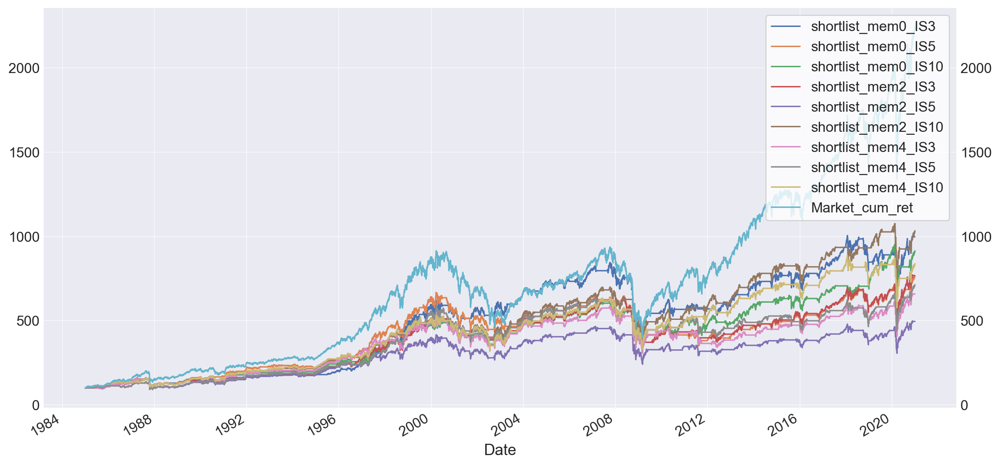

In [11]:
for df, m, strat_name in zip(all_dfs_short, all_metrics_short, all_names_short):
    absret = df['Strat_cum_ret'].iloc[-1].round(0)
    ir = m['IR'].iloc[0].round(2)
    print(f'{strat_name}: \tAbsRet: {absret} \tIR: {ir}')
    _ = df['Strat_cum_ret'].plot(label=strat_name, legend=True, figsize=(14,7))
_ = df['Market_cum_ret'].plot()
plt.legend(loc='upper right')
plt.show()

### Dynamic plot


In [12]:
all_strat_cum_ret = pd.DataFrame(index=all_dfs_short[0].index)

for df, strat_name in zip(all_dfs_short, all_names_short):
    all_strat_cum_ret = pd.concat([all_strat_cum_ret, df['Strat_cum_ret'].rename(strat_name)], axis=1)
for df, strat_name in zip(all_dfs_long, all_names_long):
    all_strat_cum_ret = pd.concat([all_strat_cum_ret, df['Strat_cum_ret'].rename(strat_name)], axis=1)
all_strat_cum_ret = pd.concat([all_strat_cum_ret, df['Market_cum_ret'].rename("Buy & Hold")], axis=1)
all_strat_cum_ret.head()

,shortlist_mem0_IS3,shortlist_mem0_IS5,shortlist_mem0_IS10,shortlist_mem2_IS3,shortlist_mem2_IS5,shortlist_mem2_IS10,shortlist_mem4_IS3,shortlist_mem4_IS5,shortlist_mem4_IS10,longlist_mem0_IS3,longlist_mem0_IS5,longlist_mem0_IS10,longlist_mem2_IS3,longlist_mem2_IS5,longlist_mem2_IS10,longlist_mem4_IS3,longlist_mem4_IS5,longlist_mem4_IS10,Buy & Hold
Date,,,,,,,,,,,,,,,,,,,
1985-01-02,100.0,100.0,98.870811,100.0,100.0,98.870811,100.0,100.0,98.870811,100.0,100.0,98.870811,100.0,100.0,98.870811,100.0,100.0,98.870811,98.881840
1985-01-03,100.0,100.0,98.392517,100.0,100.0,98.392517,100.0,100.0,98.392517,100.0,100.0,98.392517,100.0,100.0,98.392517,100.0,100.0,98.392517,98.403493
1985-01-04,100.0,100.0,97.860399,100.0,100.0,97.860399,100.0,100.0,97.860399,100.0,100.0,97.860399,100.0,100.0,97.860399,100.0,100.0,97.860399,97.871315
1985-01-07,100.0,100.0,98.195217,100.0,100.0,98.195217,100.0,100.0,98.195217,100.0,100.0,98.195217,100.0,100.0,98.195217,100.0,100.0,98.195217,98.206171
1985-01-08,100.0,100.0,98.045748,100.0,100.0,98.045748,100.0,100.0,98.045748,100.0,100.0,98.045748,100.0,100.0,98.045748,100.0,100.0,98.045748,98.056685


In [13]:
#fig = px.line(all_strat_cum_ret.loc[:, all_strat_cum_ret.columns.str.contains("short")], width=1200, height=650)
#fig = px.line(all_strat_cum_ret.loc[:, all_strat_cum_ret.columns.str.contains("long")], width=1200, height=650)
fig = px.line(all_strat_cum_ret, width=1200, height=650)
#fig.update_xaxes(rangeslider_visible=True)
_ = fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1),
    legend_title_text=' '
)
fig.show()

## Metrics

In [14]:
import re

def sum_digits(string):
    return sum(int(x) for x in re.findall(r'[0-9]+', string))
    #return sum(int(x) for x in string if x.isdigit())

By sorting the strategies by 'Total_IS_length' (original IS length + extra memory length), we can see how, the longer the 'Total_IS_length', the less risky the strategies (in terms of All Risk)

In [15]:
all_metrics = pd.DataFrame()
for m in all_metrics_short:
    all_metrics = pd.concat([all_metrics, m])
for m in all_metrics_long:
    all_metrics = pd.concat([all_metrics, m])
all_metrics = all_metrics.drop_duplicates().reset_index().rename(columns={"index": "Strat_name"})
all_metrics.insert(0, 'Total_IS_length', all_metrics['Strat_name'].apply(sum_digits))
all_metrics.sort_values(by=['Total_IS_length'], inplace=True)

all_metrics.style\
    .background_gradient(cmap='Greens', subset=['AbsRet', 'ARC', 'IR', 'IR**'])\
    .background_gradient(cmap='Reds', subset=['aSD', 'MD', 'AMD', 'MLD']) \
    .background_gradient(cmap='Blues', subset=['Total_IS_length', 'All Risk'])

,Total_IS_length,Strat_name,AbsRet,ARC,IR,aSD,MD,AMD,MLD,IR**,All Risk,ARCMD,ARCAMD,Num Trades,Out of market
1,0,Buy and Hold,2145.916000,9.025100,0.492200,18.336500,56.775400,14.188700,7.173200,0.078200,10.595700,0.159000,0.636100,1,0
0,3,shortlist_mem0_IS3,896.540000,6.592500,0.408800,16.124900,52.720800,12.058500,9.390800,0.051100,9.626700,0.125000,0.546700,74,3013
10,3,longlist_mem0_IS3,678.685500,5.864900,0.388500,15.097400,48.303100,10.781800,10.286100,0.047200,8.087600,0.121400,0.544000,78,4097
2,5,shortlist_mem0_IS5,663.912000,5.808600,0.357800,16.233900,54.005100,12.792700,17.796000,0.038500,19.959100,0.107600,0.454100,77,2916
4,5,shortlist_mem2_IS3,666.083200,5.816900,0.363600,15.997300,47.257500,12.525300,9.525000,0.044800,9.019300,0.123100,0.464400,76,2896
13,5,longlist_mem2_IS3,557.996300,5.371000,0.360500,14.898200,47.257500,10.843500,9.661900,0.041000,7.376300,0.113700,0.495300,78,4094
11,5,longlist_mem0_IS5,641.216300,5.720000,0.374200,15.287800,48.247000,11.122900,16.928100,0.044400,13.888200,0.118600,0.514300,75,3770
14,7,longlist_mem2_IS5,241.324300,3.467800,0.230800,15.026700,47.231000,11.859500,20.763900,0.016900,17.476900,0.073400,0.292400,74,4194
16,7,longlist_mem4_IS3,507.795600,5.139000,0.348300,14.755300,41.310000,10.904700,17.618100,0.043300,11.710500,0.124400,0.471300,76,4064
7,7,shortlist_mem4_IS3,556.968400,5.366400,0.329600,16.282100,48.114300,13.012500,10.286100,0.036800,10.485700,0.111500,0.412400,74,2787


Now we will focus on the effect of longlist and shortlist of parameters (let´s remember that longlist was often choosin a large of selling duration; causing the strategy to be long only for 2/3 months.  
Shortlist strategies have the selling_duration limited to a maximum of 6 months.  
We can see how strategies with higher Maximum Loss Duration are mainly longlist. (Because longlist strategies tend to spend less time invested, and need a longer time to recover from drawdowns)  

In [16]:
#metrics_short_sorted = all_metrics[~all_metrics.index.str.contains('longlist')].copy()
metrics_short_sorted = all_metrics.copy()
metrics_short_sorted.sort_values(by=['MLD'], inplace=True)
metrics_short_sorted.style\
    .background_gradient(cmap='Greens', subset=['AbsRet', 'ARC', 'IR', 'IR**'])\
    .background_gradient(cmap='Reds', subset=['aSD', 'MD', 'AMD', 'All Risk']) \
    .background_gradient(cmap='Blues', subset=['MLD'])

,Total_IS_length,Strat_name,AbsRet,ARC,IR,aSD,MD,AMD,MLD,IR**,All Risk,ARCMD,ARCAMD,Num Trades,Out of market
6,12,shortlist_mem2_IS10,932.153800,6.696500,0.431200,15.531100,48.114300,11.620500,5.593400,0.060000,4.857100,0.139200,0.576300,75,2793
9,14,shortlist_mem4_IS10,736.823700,6.076800,0.387700,15.671900,48.114300,12.233300,5.593400,0.049000,5.159600,0.126300,0.496700,75,2803
3,10,shortlist_mem0_IS10,813.040500,6.333800,0.393000,16.118500,48.114300,12.450300,7.107500,0.051700,6.862700,0.131600,0.508700,75,2493
1,0,Buy and Hold,2145.916000,9.025100,0.492200,18.336500,56.775400,14.188700,7.173200,0.078200,10.595700,0.159000,0.636100,1,0
0,3,shortlist_mem0_IS3,896.540000,6.592500,0.408800,16.124900,52.720800,12.058500,9.390800,0.051100,9.626700,0.125000,0.546700,74,3013
4,5,shortlist_mem2_IS3,666.083200,5.816900,0.363600,15.997300,47.257500,12.525300,9.525000,0.044800,9.019300,0.123100,0.464400,76,2896
13,5,longlist_mem2_IS3,557.996300,5.371000,0.360500,14.898200,47.257500,10.843500,9.661900,0.041000,7.376300,0.113700,0.495300,78,4094
7,7,shortlist_mem4_IS3,556.968400,5.366400,0.329600,16.282100,48.114300,13.012500,10.286100,0.036800,10.485700,0.111500,0.412400,74,2787
10,3,longlist_mem0_IS3,678.685500,5.864900,0.388500,15.097400,48.303100,10.781800,10.286100,0.047200,8.087600,0.121400,0.544000,78,4097
5,7,shortlist_mem2_IS5,394.433200,4.538000,0.282300,16.074700,48.235500,13.043100,10.904900,0.026600,11.028400,0.094100,0.347900,74,3022


Let´s focus on strategies involving only short list of parameters:

In [17]:
all_metrics[~all_metrics['Strat_name'].str.contains('longlist')].style\
    .background_gradient(cmap='Greens', subset=['AbsRet', 'ARC', 'IR', 'IR**'])\
    .background_gradient(cmap='Reds', subset=['aSD', 'MD', 'AMD', 'MLD', 'All Risk'])

,Total_IS_length,Strat_name,AbsRet,ARC,IR,aSD,MD,AMD,MLD,IR**,All Risk,ARCMD,ARCAMD,Num Trades,Out of market
1,0,Buy and Hold,2145.916000,9.025100,0.492200,18.336500,56.775400,14.188700,7.173200,0.078200,10.595700,0.159000,0.636100,1,0
0,3,shortlist_mem0_IS3,896.540000,6.592500,0.408800,16.124900,52.720800,12.058500,9.390800,0.051100,9.626700,0.125000,0.546700,74,3013
2,5,shortlist_mem0_IS5,663.912000,5.808600,0.357800,16.233900,54.005100,12.792700,17.796000,0.038500,19.959100,0.107600,0.454100,77,2916
4,5,shortlist_mem2_IS3,666.083200,5.816900,0.363600,15.997300,47.257500,12.525300,9.525000,0.044800,9.019300,0.123100,0.464400,76,2896
7,7,shortlist_mem4_IS3,556.968400,5.366400,0.329600,16.282100,48.114300,13.012500,10.286100,0.036800,10.485700,0.111500,0.412400,74,2787
5,7,shortlist_mem2_IS5,394.433200,4.538000,0.282300,16.074700,48.235500,13.043100,10.904900,0.026600,11.028400,0.094100,0.347900,74,3022
8,9,shortlist_mem4_IS5,612.161400,5.602700,0.351900,15.920400,48.235500,12.832400,12.843300,0.040900,12.656200,0.116200,0.436600,73,2959
3,10,shortlist_mem0_IS10,813.040500,6.333800,0.393000,16.118500,48.114300,12.450300,7.107500,0.051700,6.862700,0.131600,0.508700,75,2493
6,12,shortlist_mem2_IS10,932.153800,6.696500,0.431200,15.531100,48.114300,11.620500,5.593400,0.060000,4.857100,0.139200,0.576300,75,2793
9,14,shortlist_mem4_IS10,736.823700,6.076800,0.387700,15.671900,48.114300,12.233300,5.593400,0.049000,5.159600,0.126300,0.496700,75,2803


In [18]:
#fig = px.line(all_strat_cum_ret.loc[:, ~all_strat_cum_ret.columns.str.contains("short")], width=1200, height=650)
fig = px.line(all_strat_cum_ret.loc[:, ~all_strat_cum_ret.columns.str.contains("long")], width=1200, height=650)
#fig = px.line(all_strat_cum_ret, width=1200, height=650)
#fig.update_xaxes(rangeslider_visible=True)
_ = fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1),
    legend_title_text=' '
)
fig.show()

# Conclusion

I propose using the strategy with parameters: 
- 10 years IS period
- memory_len = 0
- short_list  
  
Reasons: 
- It doesn´t have the best performance, but strategies with similar lengths of IS periods have similar performance. Seems robust
- Avoid using memory_len parameters. It also wasnt used in ma_crossover. All strategies follow the same methodology
- short_list allows the strategy to accomplish the objective, which is to omit the worse performing months

In this strategy there were developed many walk forward optimisations with different combinations of parameters to be analysed ex-post. One needs to be careful with extracting conclusions this way, as it is very easy to fall into overfiting.  
Prior to this analysis, there were several intuitive ideas:
- A long list of combinatinos for selling_duration would focus on picking the months with the best performance in terms of IR. This would make the algorithm to choose the combinations that match with extraordinary performance of SP500 during very few months, which is not the original objective of this strategy.
- Using a shorter list for selling_duration forces the strategy to penalize month with bad performance, which is the original objective of the strategy. 
- IS period should be longer than in other strategies like MA crossover. Having an In Sample period of just 3 years makes the strategy to have 3 samples for each month, which could lead to overfitting. This is why the WF optimisation was tested with longer IS periods, such as 5Y and 10Y.
- memory_len parameters has a similar effect to the size of the IS period. Increasing memory len to 4, makes the algorithm to look at the weights of each parameter combination of the 4 previous IS periods. 

- Longer IS sample periods seem to perform better than shorter ones (similar IR, but lower risk, specially Maximum Loss Duration)
- Increasing the memory_len has a similar effect on the WF than increasing IS period (obviously)
- Using a short_list (limiting the selling_duration to 6 months, improves performance, and it matches better the objective of the strategy, which is to avoid months with worst performance. Rather than investing only during months with the best performance